# Downloading dataset from kaggle

In [ ]:
!pip install kaggle

In [43]:
from google.colab import files
files.upload()

Saving 32-64-256-CNN.h5 to 32-64-256-CNN.h5


{'32-64-256-CNN.h5': b'\x89HDF\r\n\x1a\n\x00\x00\x00\x00\x00\x08\x08\x00\x04\x00\x10\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\xe0Ir\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00`\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x88\x00\x00\x00\x00\x00\x00\x00\xa8\x02\x00\x00\x00\x00\x00\x00\x01\x00\x07\x00\x01\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x10\x00\x10\x00\x00\x00\x00\x00 \x03\x00\x00\x00\x00\x00\x00h\x01\x00\x00\x00\x00\x00\x00TREE\x00\x00\x01\x00\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\xff\x00\x00\x00\x00\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x18\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0

In [2]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/

!chmod 600 ~/.kaggle/kaggle.json

In [3]:
!kaggle datasets download -d meowmeowmeowmeowmeow/gtsrb-german-traffic-sign

 97% 593M/612M [00:04<00:00, 113MB/s]
100% 612M/612M [00:04<00:00, 143MB/s]


In [4]:
from zipfile import ZipFile

file_name = "gtsrb-german-traffic-sign.zip"

with ZipFile(file_name, "r") as zip:
  zip.extractall()
  print("DONE!")

DONE!


# Importing the modules

In [5]:
# Here we begin our work oh yeah
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import tqdm
import os
import cv2

In [6]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Flatten, Dropout
from tensorflow.keras.utils import to_categorical

In [7]:
classes = { 1:'Speed limit (20km/h)',
            2:'Speed limit (30km/h)', 
            3:'Speed limit (50km/h)', 
            4:'Speed limit (60km/h)', 
            5:'Speed limit (70km/h)', 
            6:'Speed limit (80km/h)', 
            7:'End of speed limit (80km/h)', 
            8:'Speed limit (100km/h)', 
            9:'Speed limit (120km/h)', 
            10:'No passing', 
            11:'No passing veh over 3.5 tons', 
            12:'Right-of-way at intersection', 
            13:'Priority road', 
            14:'Yield', 
            15:'Stop', 
            16:'No vehicles', 
            17:'Veh > 3.5 tons prohibited', 
            18:'No entry', 
            19:'General caution', 
            20:'Dangerous curve left', 
            21:'Dangerous curve right', 
            22:'Double curve', 
            23:'Bumpy road', 
            24:'Slippery road', 
            25:'Road narrows on the right', 
            26:'Road work', 
            27:'Traffic signals', 
            28:'Pedestrians', 
            29:'Children crossing', 
            30:'Bicycles crossing', 
            31:'Beware of ice/snow',
            32:'Wild animals crossing', 
            33:'End speed + passing limits', 
            34:'Turn right ahead', 
            35:'Turn left ahead', 
            36:'Ahead only', 
            37:'Go straight or right', 
            38:'Go straight or left', 
            39:'Keep right', 
            40:'Keep left', 
            41:'Roundabout mandatory', 
            42:'End of no passing', 
            43:'End no passing veh > 3.5 tons' }
  
no_of_classes = 43
path = "Train"
# Iterating through all the classes and printing out the number of images in each class


 # Visualize the data

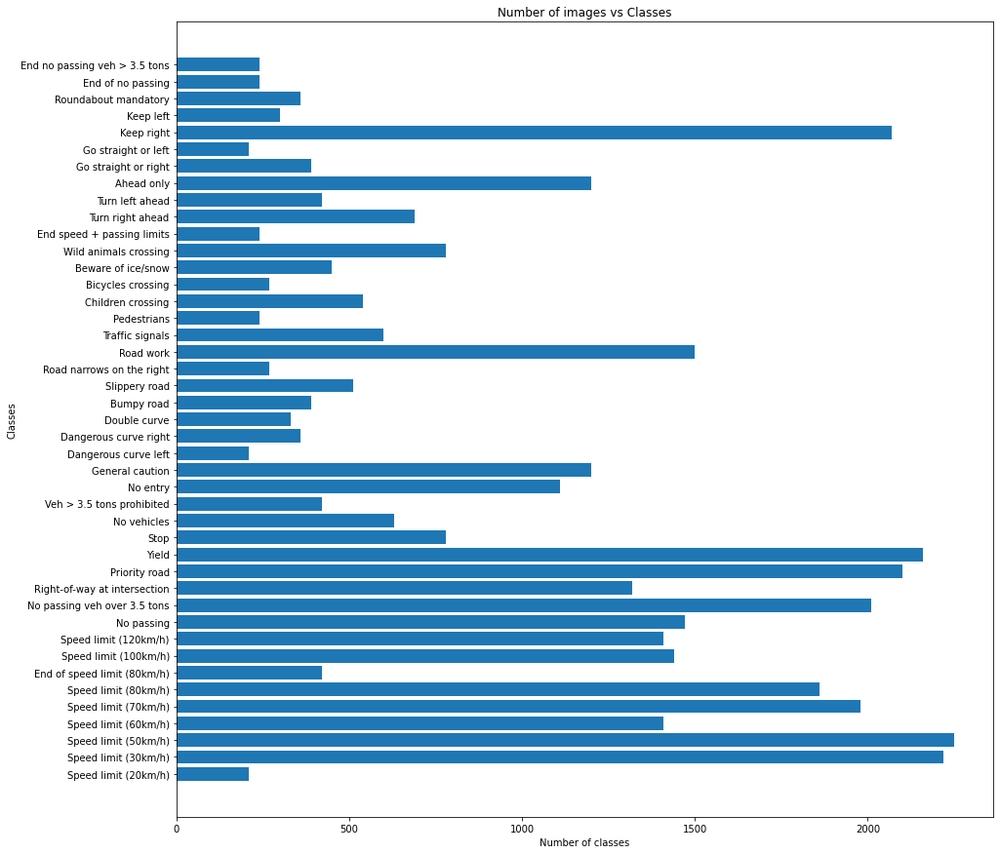

In [42]:
data = []

for i in range(no_of_classes):
  new_path = os.path.join(path, str(i))
  # print("Class ", i+1, ": ", len([img for img in os.listdir(new_path)]))
  data.append([i+1, len([img for img in os.listdir(new_path)])])
data = np.array(data)
# plt.bar(data[:, 0], data[:, 1], )
plt.figure(figsize=(15,15))
plt.barh(np.arange(43), data[:, 1])
plt.yticks(np.arange(43), classes.values())
plt.title('Number of images vs Classes')
plt.ylabel('Classes')
plt.xlabel('Number of classes')
plt.show()


<class 'numpy.ndarray'>
(30, 30, 3)


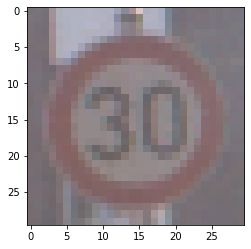

In [ ]:
# Just to check the extraction of the image from tehe 
img = cv2.imread("Train/1/00001_00000_00007.png")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.resize(img, (30, 30))
print(type(img))
print(img.shape)
plt.imshow(img)

# Variation of dimensions of the images of a class

In [26]:
# Plotting the variation of dimensions of the images of a particular class.

new_path = os.path.join(path, str(1))
gx = []
gy = []

for img in os.listdir(new_path):
  # Get the shape of the image.
  res_img = cv2.imread(os.path.join(new_path, img))
  w, h, c = res_img.shape
  # Add these dims to a list.
  gx.append(w)
  gy.append(h)

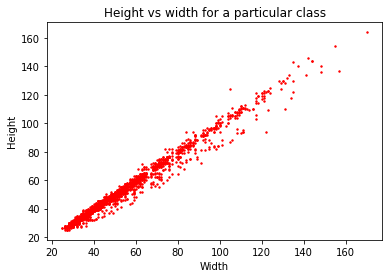

In [28]:
plt.scatter(gx, gy, color = 'red', s = 2)
plt.xlabel('Width')
plt.ylabel('Height')
plt.title('Height vs width for a particular class')
plt.show()

# Extraction of images using "OS" module

In [45]:
X = []
y = []

# We need to go through each data
img_size = 30


for i in range(no_of_classes):
  new_path = os.path.join(path, str(i))
  for img in tqdm(os.listdir(new_path)):

    res_img = cv2.imread(os.path.join(new_path, img))
    res_img = cv2.cvtColor(res_img, cv2.COLOR_BGR2RGB)
    new_img = cv2.resize(res_img, (img_size, img_size))

    X.append(new_img)
    y.append(i)


100%|██████████| 240/240 [00:00<00:00, 6457.87it/s]


In [46]:
X = np.array(X)
y = np.array(y)

print("shape of X: ", X.shape)
print("shape of y: ", y.shape)


shape of X:  (39209, 30, 30, 3)
shape of y:  (39209,)


# Randomize the data

In [47]:
# Here we will shuffle the data acquired.

from sklearn.utils import shuffle
X, y = shuffle(X, y)
y = to_categorical(y)

# Splitting the data into train and validation set

In [ ]:
# Here we will split the data set for validation.

n = len(X)
k = (int)(0.2*n)
X_train, X_val = X[k:], X[:k]
y_train, y_val = y[k:], y[:k]

print("shape of X_train, X_val: ", X_train.shape, X_val.shape)
print("shape of y: ", y_train.shape, y_val.shape)

# Now we can work on the model

shape of X_train, X_val:  (31368, 30, 30, 3) (7841, 30, 30, 3)
shape of y:  (31368, 43) (7841, 43)


# Building the model

In [ ]:
# Now we have our preprocesses data.
# Build the model from here

model = Sequential()

# MODEL can be built as follows: 

model.add( Conv2D(32, (3,3), activation="relu", input_shape = (img_size, img_size,3)) )
model.add( MaxPooling2D(pool_size = (2,2)) )
model.add( Dropout(rate = 0.25) )

model.add( Conv2D(64, (3,3), activation="relu") )
model.add( MaxPooling2D(pool_size = (2,2)) )
model.add( Dropout(rate = 0.25) )

model.add(Flatten())

model.add( Dense(256, activation = "relu") )
model.add( Dense(43, activation = "softmax") )

model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])


# Model summary

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 28, 28, 32)        896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 14, 14, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 12, 12, 64)        18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 6, 6, 64)          0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 6, 6, 64)          0         
_________________________________________________________________
flatten (Flatten)            (None, 2304)              0

# Fitting the model

In [ ]:
history = model.fit(X_train, y_train, batch_size = 32, epochs = 15, validation_data=(X_val, y_val))

Epoch 1/15
981/981 [==============================] - 37s 4ms/step - loss: 6.6792 - accuracy: 0.2744 - val_loss: 0.4798 - val_accuracy: 0.8732
Epoch 2/15
981/981 [==============================] - 4s 4ms/step - loss: 0.6573 - accuracy: 0.8084 - val_loss: 0.1880 - val_accuracy: 0.9514
Epoch 3/15
981/981 [==============================] - 4s 4ms/step - loss: 0.3770 - accuracy: 0.8916 - val_loss: 0.1663 - val_accuracy: 0.9527
Epoch 4/15
981/981 [==============================] - 4s 4ms/step - loss: 0.2847 - accuracy: 0.9197 - val_loss: 0.1087 - val_accuracy: 0.9703
Epoch 5/15
981/981 [==============================] - 4s 4ms/step - loss: 0.2435 - accuracy: 0.9314 - val_loss: 0.1037 - val_accuracy: 0.9710
Epoch 6/15
981/981 [==============================] - 3s 4ms/step - loss: 0.2447 - accuracy: 0.9308 - val_loss: 0.1673 - val_accuracy: 0.9580
Epoch 7/15
981/981 [==============================] - 3s 4ms/step - loss: 0.2355 - accuracy: 0.9364 - val_loss: 0.0999 - val_accuracy: 0.9746
Epoch

# Plotting the accuracy and loss curve

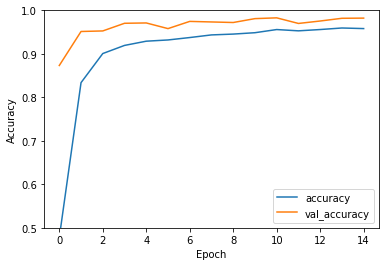

In [ ]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0.5, 1])
plt.legend(loc='lower right')

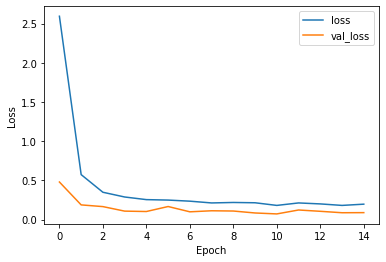

In [ ]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label = 'val_loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
# plt.ylim([0.5, 1])
plt.legend(loc='upper right')

# Evaluating the test data.

In [48]:
# Here we will load the test data set.
data = pd.read_csv("Test.csv")

X_test = []
y_test = []

for i in range(len(data)):
  # Here we read the image, resize it and add to the test dataset.
  res_img = cv2.imread(data.iloc[i, -1])
  res_img = cv2.cvtColor(res_img, cv2.COLOR_BGR2RGB)
  new_img = cv2.resize(res_img, (img_size, img_size))

  X_test.append(new_img)
  y_test.append(data.iloc[i, -2])

X_test = np.array(X_test)
y_test = np.array(y_test)

# X_test.shape

General caution


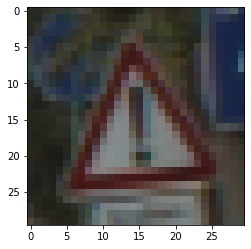

In [50]:
idx = 1412
plt.imshow(X_test[idx])
print(classes[y_test[idx]+1])

In [ ]:
# Ok so now we evaluate the model using test data
y_test = to_categorical(y_test)
val_loss, val_acc = model.evaluate(X_test, y_test)

print("Loss: ", val_loss)
print("Accuracy: ", val_acc)

y_pred = model.predict(X_test)

395/395 [==============================] - 1s 3ms/step - loss: 0.5189 - accuracy: 0.9262
Loss:  0.5189319849014282
Accuracy:  0.926207423210144


# Predicting a test image

The model predicted :  Keep right


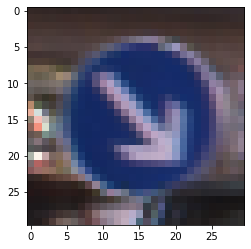

In [ ]:
# Suppose we want to know the prediction for 3rd image, then

print("The model predicted : ", classes[np.argmax(y_pred[2]) + 1])
plt.imshow(X_test[2])

In [ ]:
import h5py

model.save("32-64-256-CNN.h5")

In [ ]:
from tensorflow.keras.models import load_model
model2 = load_model("32-64-256-CNN.h5")
y_pred2 = model2.predict(X_test)


The model predicted :  Speed limit (60km/h)


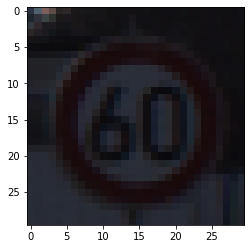

In [58]:
idx = 5231
print("The model predicted : ", classes[np.argmax(y_pred2[idx]) + 1])
plt.imshow(X_test[idx])